In [1]:
import h5py
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import geopandas as gpd


In [2]:

# Extract to a list all files in the directory
def list_files(directory):
    return [f for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))]

# Extract to a list all directories in the directory
path = '../data/Cambodia/'
files = list_files(path)

files_path = [os.path.join(path, f) for f in files]


In [3]:
# Load points_within
points_within = np.load('../data/points_within.npy', allow_pickle=True)

In [4]:
path = '../data/MOD13Q1.A2024225.mosaic.061.2024310230441.psrpgs_000502298860.250m_16_days_EVI.h5'

# Open the file and read the data
with h5py.File(path, 'r') as file:
    print(f"Keys: {list(file.keys())}")
    # Extract the group name
    group = list(file.keys())[0]
    print(f"Group: {group}")
    # Extract the subgroups
    subgroups = list(file[group].keys())
    print(f"Subgroups: {subgroups}")
    # Extract the first subgroup
    data = file[f"{group}/{subgroups[0]}"][:]
    print("Dimensions", file[f"{group}/{subgroups[1]}"])
    # Extract name
    name = subgroups[0]
    # Add name with the file name
    name = os.path.basename(path) + "_" + name

print(f"Data shape: {data.shape}")
print(f"Name: {name}")

Keys: ['MODIS_Grid_16DAY_250m_500m_VI']
Group: MODIS_Grid_16DAY_250m_500m_VI
Subgroups: ['250m 16 days EVI', 'Dimensions']
Dimensions <HDF5 group "/MODIS_Grid_16DAY_250m_500m_VI/Dimensions" (0 members)>
Data shape: (2576, 1398)
Name: MOD13Q1.A2024225.mosaic.061.2024310230441.psrpgs_000502298860.250m_16_days_EVI.h5_250m 16 days EVI


In [5]:
# Separate the files that includes NDVI and EVI
ndvi_files = [f for f in files_path if 'NDVI' in f]
evi_files = [f for f in files_path if 'EVI' in f]
ndvi_files_names = [f.split('/')[-1] for f in ndvi_files]
evi_files_names = [f.split('/')[-1] for f in evi_files]

# This files are in a longitude and latitude range
lat_range = [12.3, 13.8]
long_range = [102.3, 103.8]

# Given this range and the data is in shape 721,707 grid, do a grid array
lat_grid = np.linspace(lat_range[0], lat_range[1], 721)
long_grid = np.linspace(long_range[0], long_range[1], 707)

# Create a meshgrid
long_grid, lat_grid = np.meshgrid(long_grid, lat_grid)

In [178]:
import re

# Extract the date from the file name
# The year and DOY is after MOD13Q1. and before the .mosaic
date = re.findall(r'MOD13Q1\.A(.*?)\.mosaic', ndvi_files_names[0])[0]
print(f"Date: {date}")
year = date[:4]
doy = date[4:]
print(f"Year: {year}, DOY: {doy}")

# Transform the doy to date
from datetime import datetime, timedelta

date = datetime(int(year), 1, 1) + timedelta(int(doy) - 1)
date = date.strftime('%Y-%m-%d')
print(f"Date: {date}")

Date: 2020145
Year: 2020, DOY: 145
Date: 2020-05-24


In [179]:
def extract_date_from_name(file_name):
    date = re.findall(r'MOD13Q1\.A(.*?)\.mosaic', file_name)[0]
    year = date[:4]
    doy = date[4:]
    date = datetime(int(year), 1, 1) + timedelta(int(doy) - 1)
    date = date.strftime('%Y-%m-%d')
    return date

In [180]:
def read_EVI_NDVI(file, filename):
    # Open the file
    with h5py.File(file, 'r') as f:
        # Extract the group name
        group = list(f.keys())[0]
        # Extract the subgroups
        subgroups = list(f[group].keys())
        # Extract the first subgroup
        data = f[f"{group}/{subgroups[0]}"][:]
        # Extract name
        name = subgroups[0]
        # Add name with the file name
        name = filename + "_" + name

    return data, name


In [181]:
extract_date_from_name(ndvi_files_names[0])

'2020-05-24'

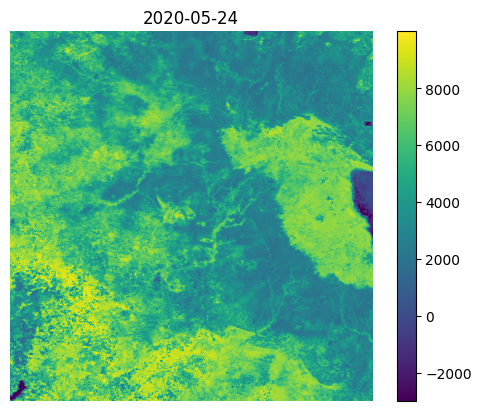

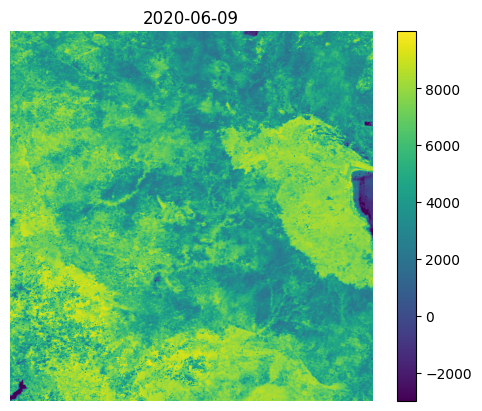

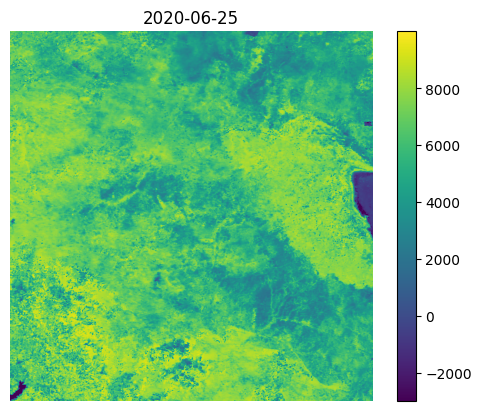

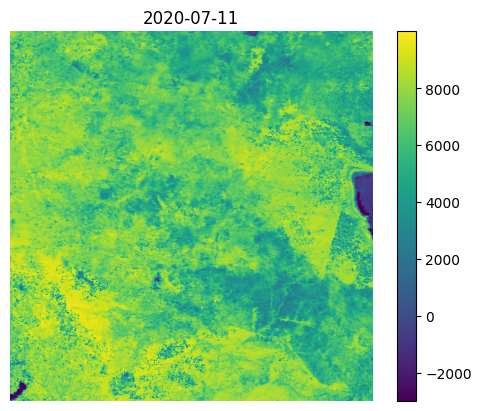

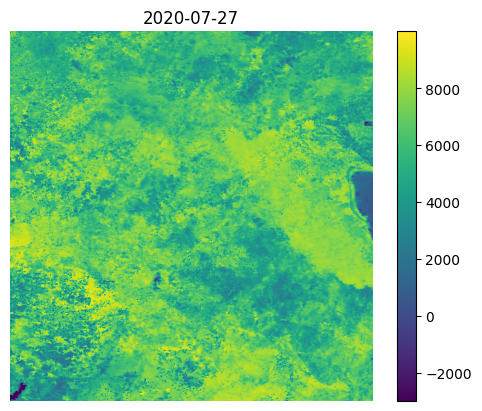

...

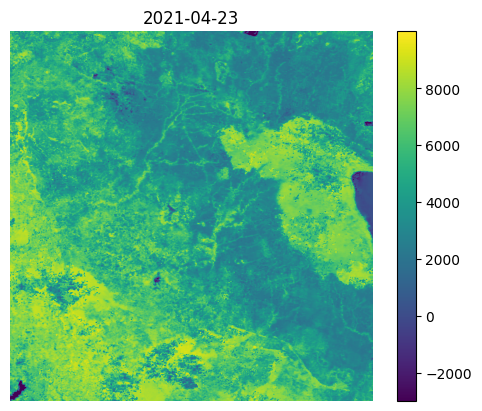

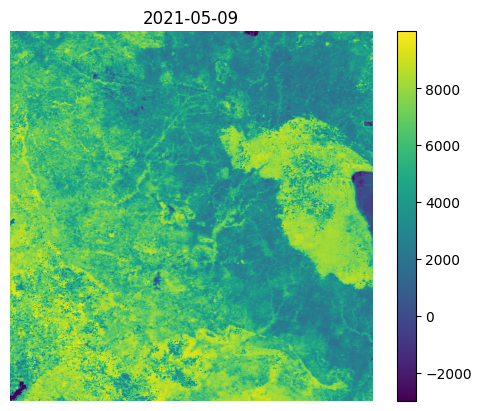

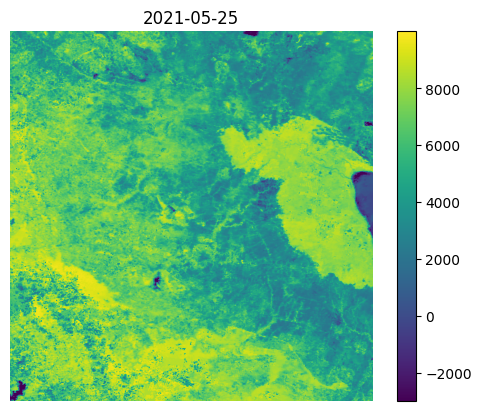

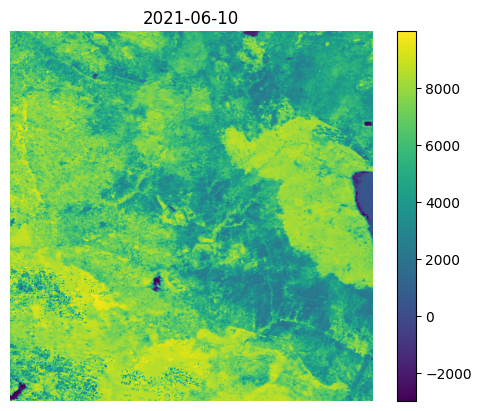

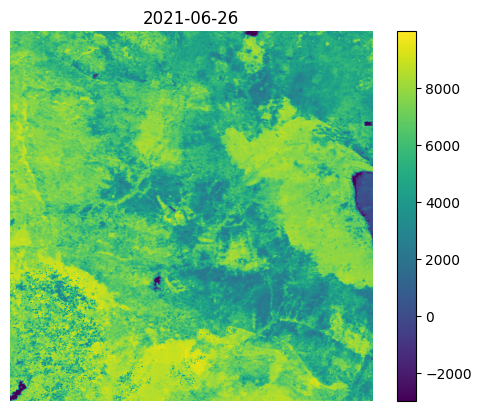

In [182]:
# Read the data and plot it
for file in ndvi_files:
    data, name = read_EVI_NDVI(file, os.path.basename(file))
    title = extract_date_from_name(os.path.basename(file))
    plt.imshow(data)
    plt.colorbar()
    plt.title(title)
    plt.axis('off')
    plt.show()

In [183]:
long_flat = long_grid.flatten()
lat_flat = lat_grid.flatten()

In [184]:
from scipy.spatial import KDTree

# Create a mask for lat and long inside the points_within
mask = np.zeros_like(lat_flat)

# Combine lat and long into a single array of points
points = np.column_stack((lat_flat, long_flat))

# Create a KDTree for fast nearest neighbor search
tree = KDTree(points)

for point in points_within:
    lat = point.y
    long = point.x
    # Find the closest point in the KDTree
    dist, idx = tree.query([lat, long])
    mask[idx] = 1

In [185]:
# Create an empty list to store GeoDataFrames
gdfs = []

# Process NDVI files
for file in ndvi_files:
    filename = file.split('/')[-1]
    data, name = read_EVI_NDVI(file, filename)
    
    # Flatten the data and the meshgrid
    data = data.flatten()
    long = long_grid.flatten()
    lat = lat_grid.flatten()

    # Only select points with points_within
    data = data[mask == 1]
    long = long[mask == 1]
    lat = lat[mask == 1]

    # Create a DataFrame
    df = pd.DataFrame({'latitude': lat, 'longitude': long, 'value': data})
    
    # Create a GeoDataFrame
    gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude))
    gdf['type'] = "NDVI"

    # Extract the date from the file name
    gdf['date'] = extract_date_from_name(filename)
    
    # Append to the list of GeoDataFrames
    gdfs.append(gdf)

In [186]:
# Combine all GeoDataFrames into a single GeoDataFrame
gdf_total = pd.concat(gdfs)

In [187]:
gdf_total['date'].unique()

array(['2020-05-24', '2020-06-09', '2020-06-25', '2020-07-11',
       '2020-07-27', '2020-08-12', '2020-08-28', '2020-09-13',
       '2020-09-29', '2020-10-15', '2020-10-31', '2020-11-16',
       '2020-12-02', '2020-12-18', '2021-01-01', '2021-01-17',
       '2021-02-02', '2021-02-18', '2021-03-06', '2021-03-22',
       '2021-04-07', '2021-04-23', '2021-05-09', '2021-05-25',
       '2021-06-10', '2021-06-26'], dtype=object)

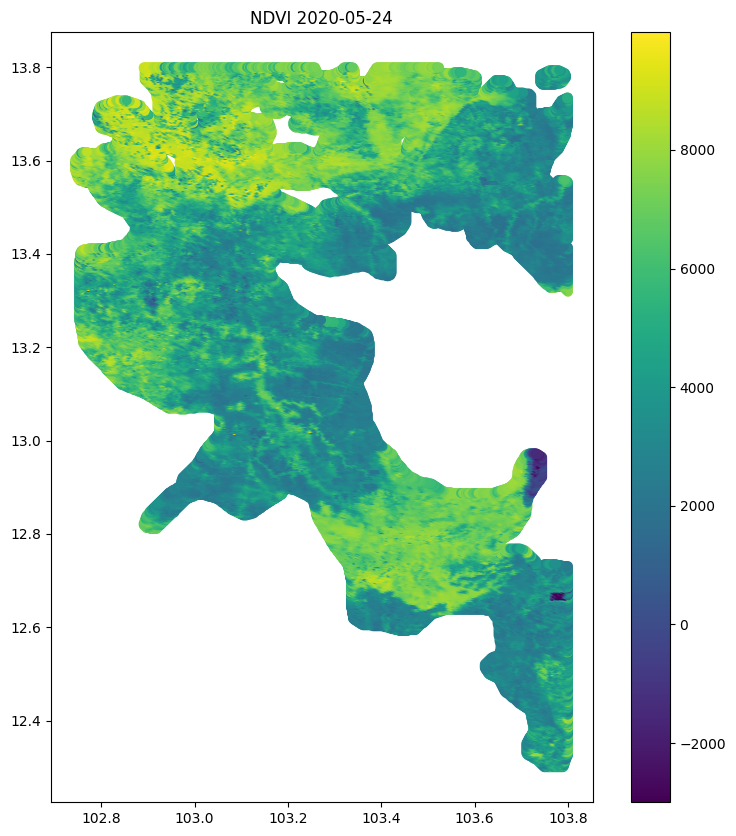

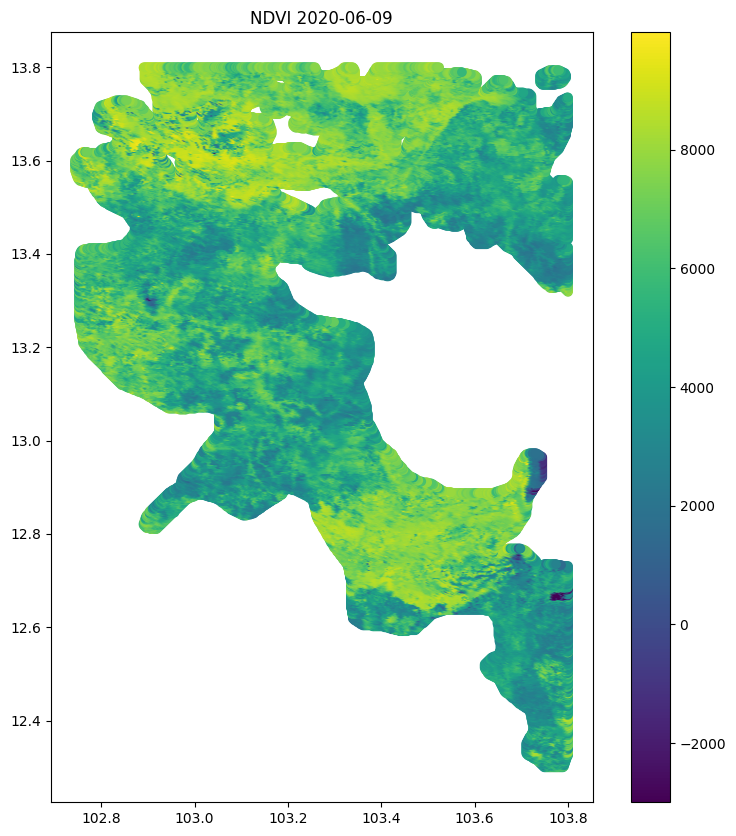

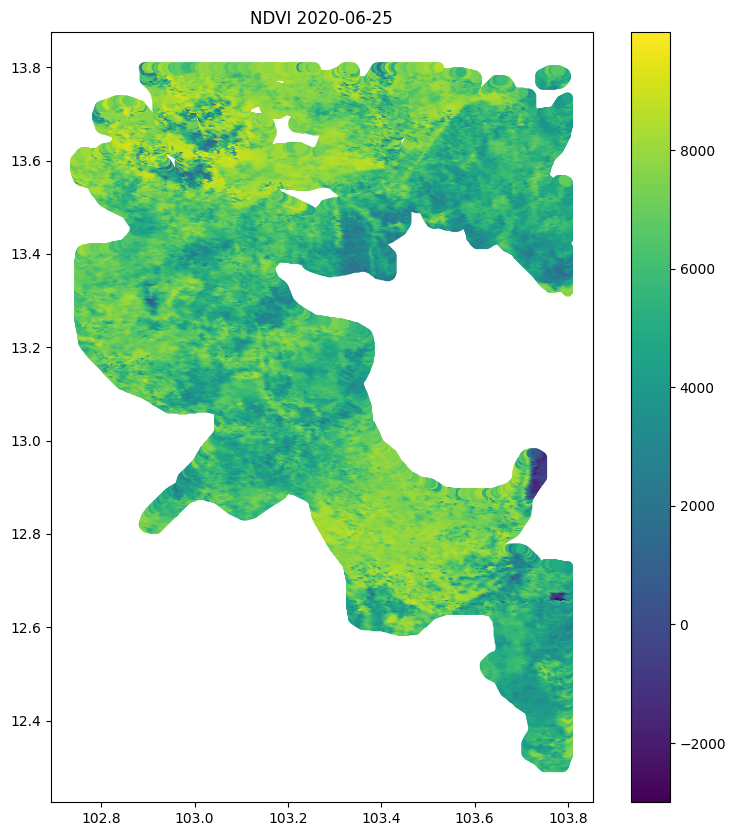

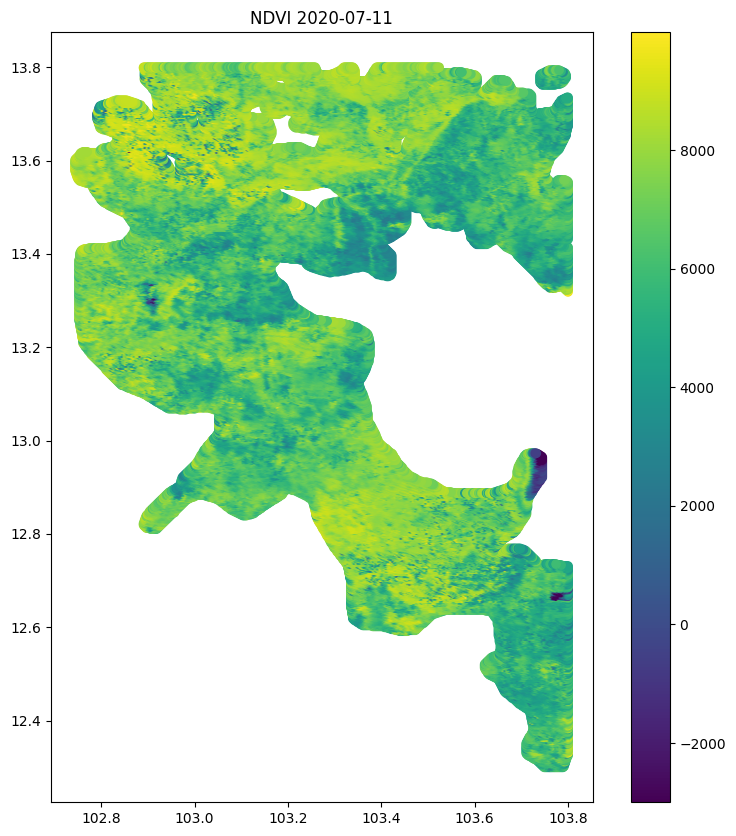

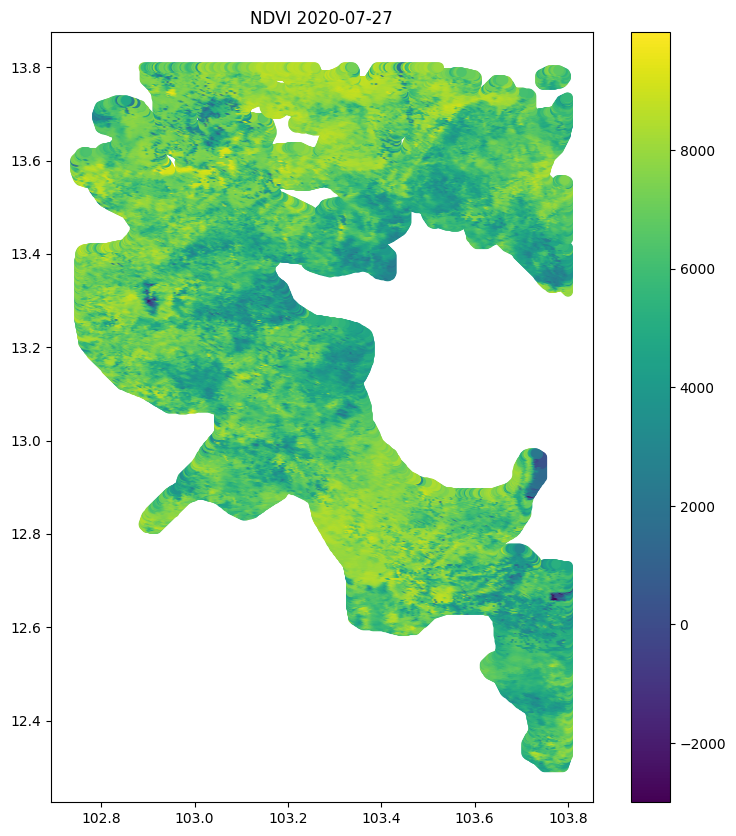

...

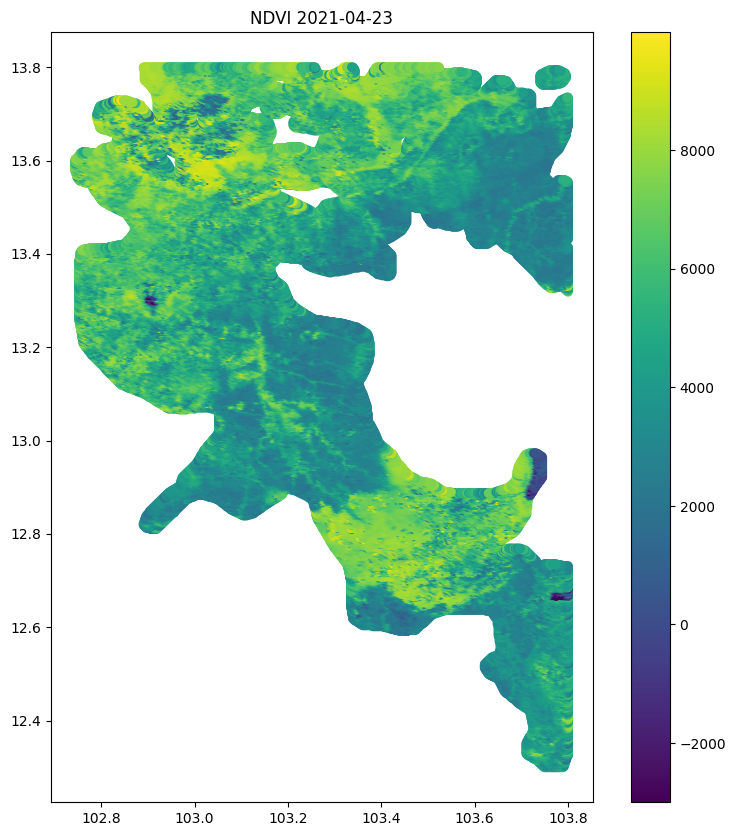

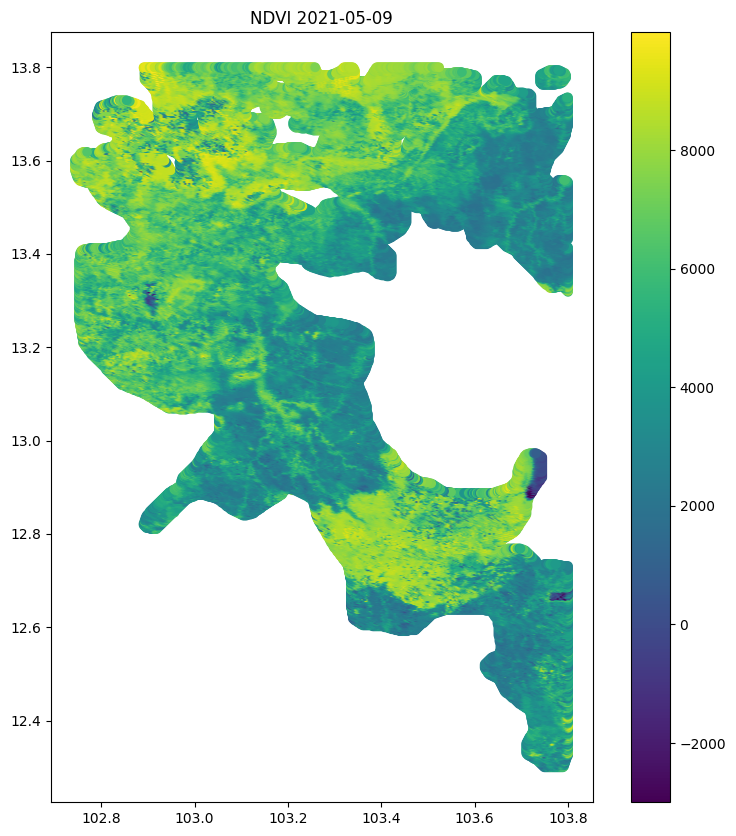

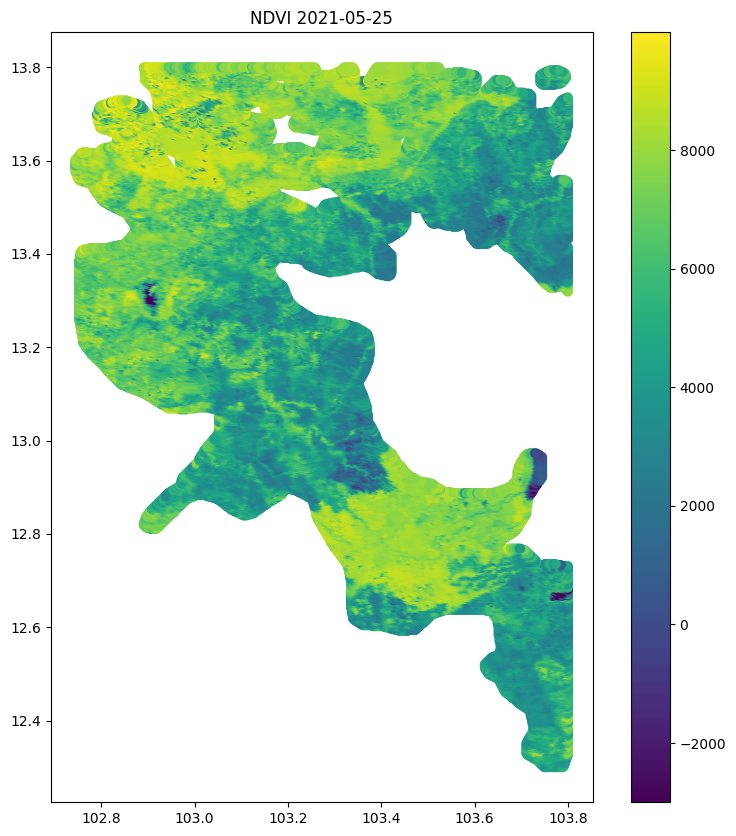

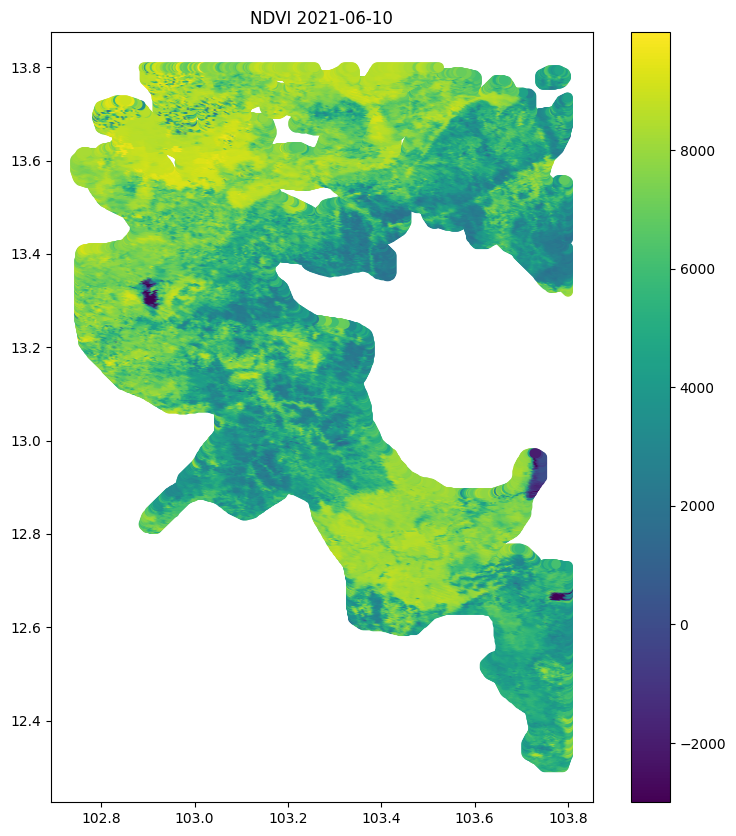

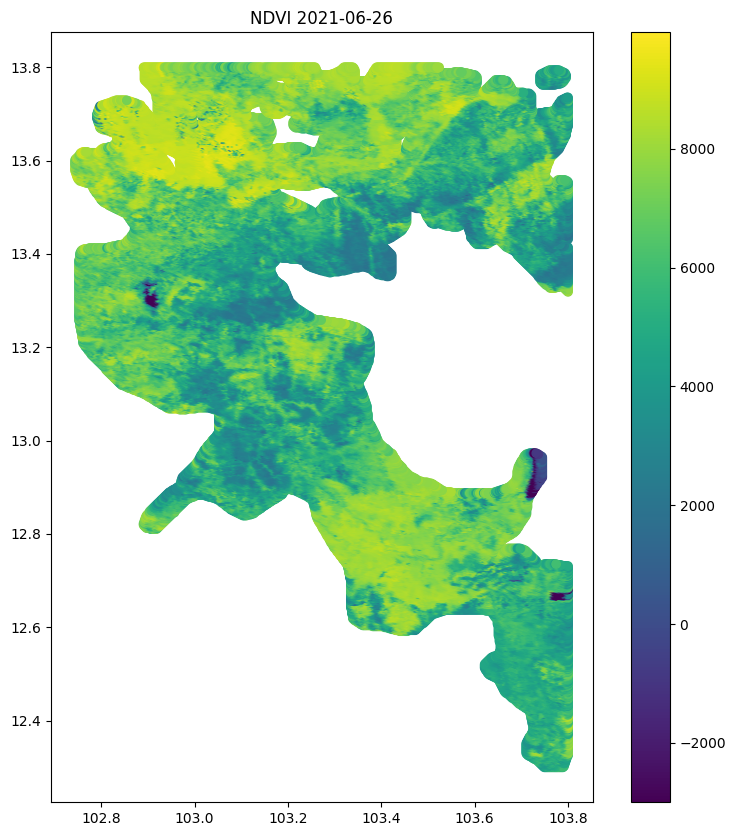

In [188]:
# Plot for all unique dates
for date in gdf_total['date'].unique():
    gdf = gdf_total[gdf_total['date'] == date]
    fig, ax = plt.subplots(figsize=(10, 10))
    gdf.plot(column='value', ax=ax, legend=True, cmap='viridis')
    ax.set_title(f"NDVI {date}")
    plt.show()

In [189]:
import geopandas as gpd
gdf_rice = gpd.read_file('../data/Rice_Cambodia_2014.geojson')

print("Current CRS:", gdf_rice.crs)

Current CRS: EPSG:4326


In [190]:
# Re-project to a suitable projected CRS (e.g., UTM zone 33N)
projected_gdf = gdf_rice.to_crs(epsg=32648)

In [191]:
# Perform the buffer operation
buffered_gdf = projected_gdf.buffer(1000)  # Buffer by 1000 meters

# Re-project back to the original CRS if needed
buffered_gdf = buffered_gdf.to_crs(gdf_rice.crs)

# Convert buffered geometries back to a GeoDataFrame
buffered_gdf = gpd.GeoDataFrame(geometry=buffered_gdf)


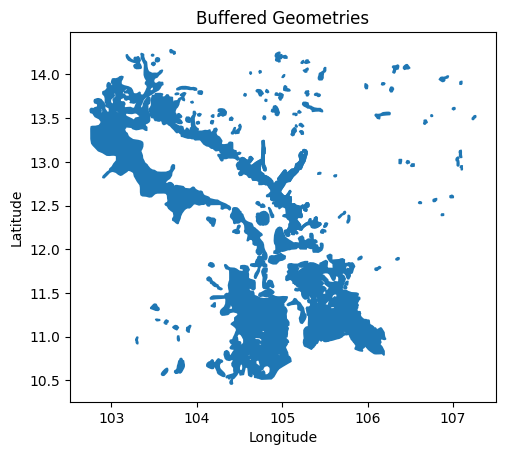

In [192]:
# Plot the buffered geometries
buffered_gdf.plot()
plt.title('Buffered Geometries')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [193]:
# Extract only the buffered geometries that are in the range
buffered_gdf = buffered_gdf.cx[long_range[0]:long_range[1], lat_range[0]:lat_range[1]]


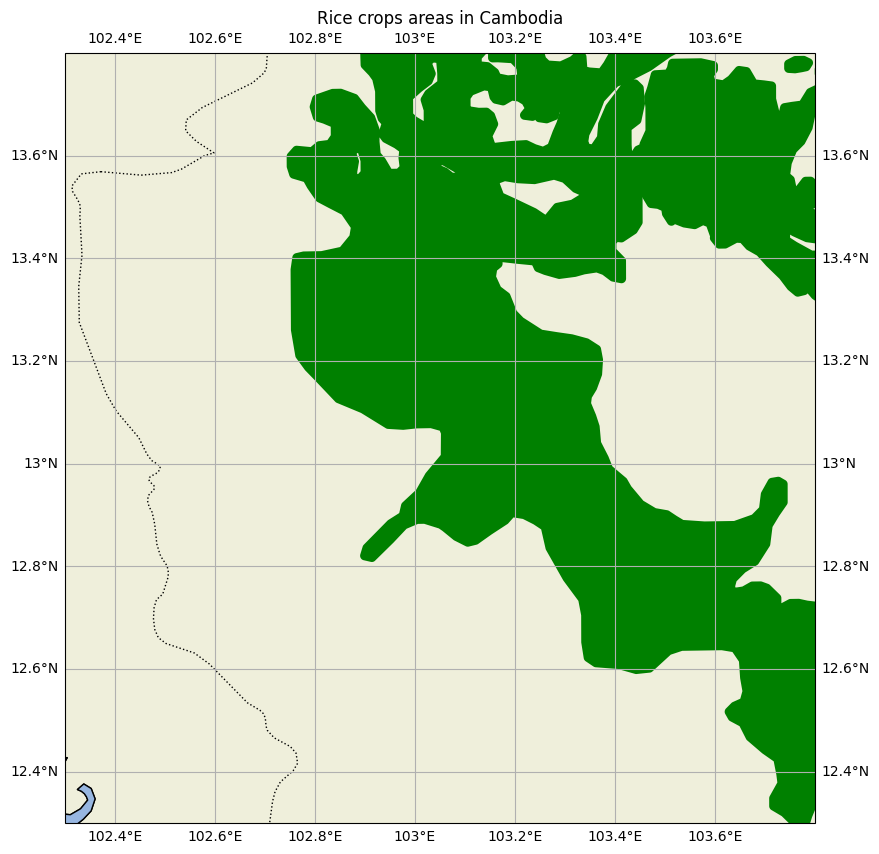

In [194]:
# Plot with cartopy too
import cartopy.crs as ccrs
import cartopy.feature as cfeature

fig, ax = plt.subplots(figsize=(10, 10), subplot_kw={'projection': ccrs.PlateCarree()})
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.LAND, edgecolor='black')
ax.add_feature(cfeature.OCEAN)

# Plot the buffered geometries
buffered_gdf.plot(ax=ax, facecolor='green')

# Set the extent
ax.set_extent([long_range[0], long_range[1], lat_range[0], lat_range[1]])

plt.title('Rice crops areas in Cambodia')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Add grid
ax.gridlines(draw_labels=True)
plt.show()


In [195]:
# From gdf_total, get the mean, std and median for each date
gdf_total['value'] = gdf_total['value'].astype(float)

# Change the date into a datetime object
gdf_total['date'] = pd.to_datetime(gdf_total['date'])

# Group by date
grouped = gdf_total.groupby('date')['value']

# Calculate the mean, std, and median for each date
mean = grouped.mean()
std = grouped.std()
median = grouped.median()





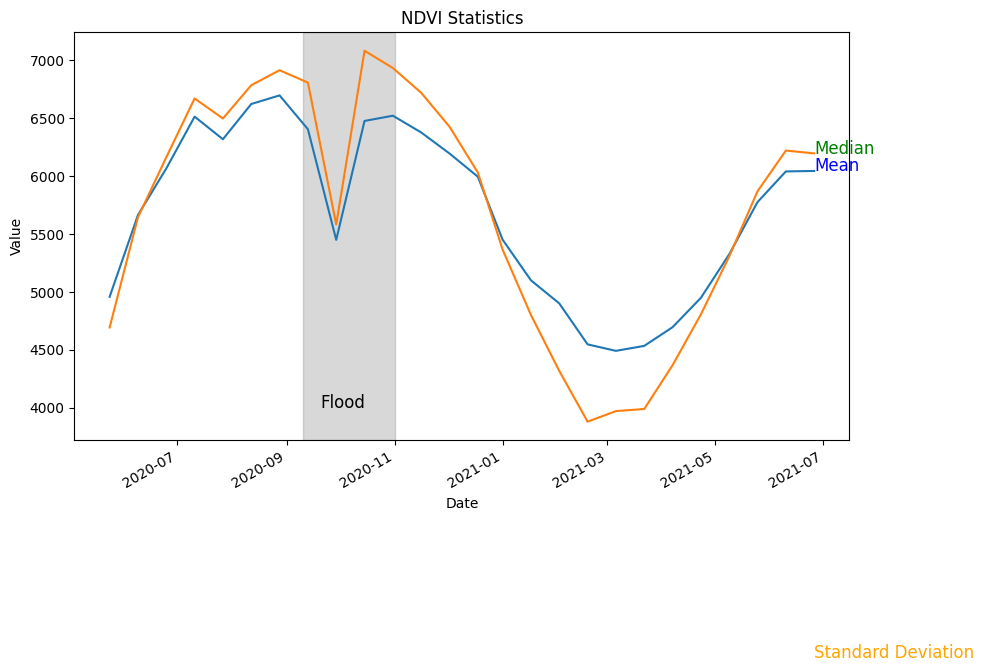

In [196]:
# Plot
fig, ax = plt.subplots(figsize=(10, 6))
mean.plot(ax=ax, label='Mean')
#std.plot(ax=ax, label='Standard Deviation')
median.plot(ax=ax, label='Median')
ax.set_title('NDVI Statistics')
ax.set_xlabel('Date')
ax.set_ylabel('Value')

# Instead of showing the legend, use text in each line
ax.text(mean.index[-1], mean.iloc[-1], 'Mean', color='blue', fontsize=12)
ax.text(std.index[-1], std.iloc[-1], 'Standard Deviation', color='orange', fontsize=12)
ax.text(median.index[-1], median.iloc[-1], 'Median', color='green', fontsize=12)

# Add a gray rectnagular region from 2020-09-10 to 2020-11-01
ax.axvspan('2020-09-10', '2020-11-01', color='gray', alpha=0.3)

# Add text in shaded area saying "Flood"
ax.text('2020-09-20', 4000, 'Flood', fontsize=12, color='black')
plt.show()

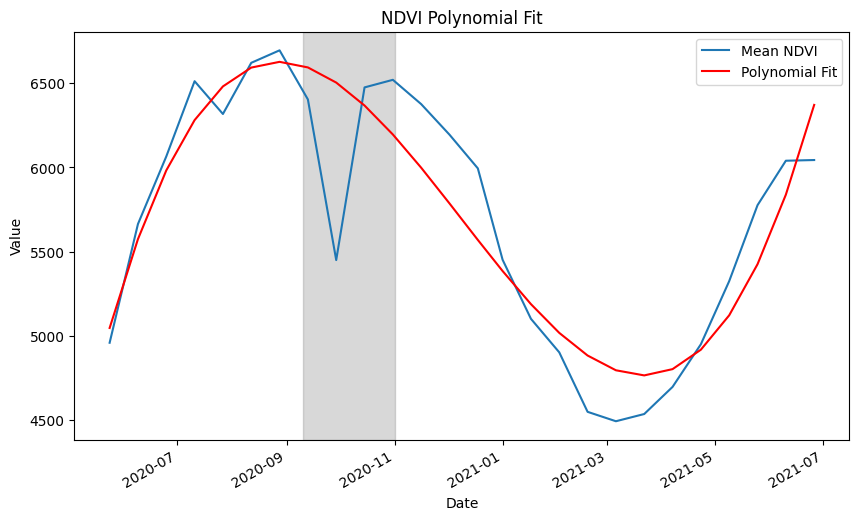

In [197]:
# Fit a polynomial to the mean NDVI values
from numpy.polynomial import Polynomial

# Extract the x and y values
x = mean.index.to_julian_date()
y = mean.values

# Fit a 3rd degree polynomial
p = Polynomial.fit(x, y, 3)

# Evaluate the polynomial
y_fit = p(x)

# Plot the data and the polynomial fit
fig, ax = plt.subplots(figsize=(10, 6))
mean.plot(ax=ax, label='Mean NDVI')
ax.plot(mean.index, y_fit, label='Polynomial Fit', color='red')
ax.set_title('NDVI Polynomial Fit')
ax.set_xlabel('Date')
ax.set_ylabel('Value')
ax.legend()

ax.axvspan('2020-09-10', '2020-11-01', color='gray', alpha=0.3)

# Add text 
plt.show()

In [198]:
# Create an empty list to store GeoDataFrames
gdfs_2 = []

# Process NDVI files
for file in evi_files:
    filename = file.split('/')[-1]
    data, name = read_EVI_NDVI(file, filename)
    
    # Flatten the data and the meshgrid
    data = data.flatten()
    long = long_grid.flatten()
    lat = lat_grid.flatten()

    # Only select points with points_within
    data = data[mask == 1]
    long = long[mask == 1]
    lat = lat[mask == 1]

    # Create a DataFrame
    df = pd.DataFrame({'latitude': lat, 'longitude': long, 'value': data})
    
    # Create a GeoDataFrame
    gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude))
    gdf['type'] = "EVI"

    # Extract the date from the file name
    gdf['date'] = extract_date_from_name(filename)
    
    # Append to the list of GeoDataFrames
    gdfs_2.append(gdf)

# Combine all GeoDataFrames into a single GeoDataFrame
gdf_total_2 = pd.concat(gdfs_2)

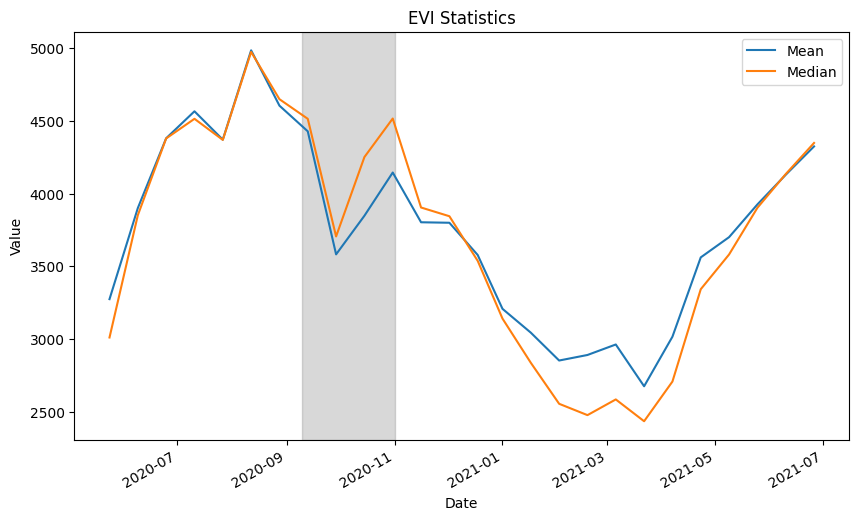

In [199]:
# Plot
fig, ax = plt.subplots(figsize=(10, 6))
mean_2.plot(ax=ax, label='Mean')
#std_2.plot(ax=ax, label='Standard Deviation')
median_2.plot(ax=ax, label='Median')
ax.set_title('EVI Statistics')
ax.set_xlabel('Date')
ax.set_ylabel('Value')
ax.legend()

# Add a gray rectnagular region from 2020-09-10 to 2020-11-01
ax.axvspan('2020-09-10', '2020-11-01', color='gray', alpha=0.3)
plt.show()

In [200]:
# Calculate mean, std, and median for each date
gdf_total_2['value'] = gdf_total_2['value'].astype(float)
gdf_total_2['date'] = pd.to_datetime(gdf_total_2['date'])

grouped_2 = gdf_total_2.groupby('date')['value']

mean_2 = grouped_2.mean()
std_2 = grouped_2.std()
median_2 = grouped_2.median()

In [201]:
def log_normal_interpolation(x, y, x_new):
    # Fit a polynomial to the log of the data
    p = Polynomial.fit(x, np.log(y), 3)
    
    # Evaluate the polynomial at the new x values
    y_new = np.exp(p(x_new))
    
    return y_new

In [202]:
# Assuming the maximum flood depth was 5 meters, interpolate the values of EVI and NDVI from the range
# and the flood depth, and create a new dataset

max_obs_flood = 1.5 # meters
mean_obs = mean.loc['2020-09-10':'2020-11-01']
mean_2_obs = mean_2.loc['2020-09-10':'2020-11-01']
min_ndvi_date = mean_obs.idxmin()
print(f"Minimum NDVI date: {min_ndvi_date}")




Minimum NDVI date: 2020-09-29 00:00:00


In [203]:
# Interpolate flood depth between 0 and 5 meters between 2020-09-10 and the minimum NDVI date
flood_dates = pd.date_range('2020-09-10', min_ndvi_date)
flood_depth = np.linspace(0, max_obs_flood, len(flood_dates))

# Combine info in a dataframe
flood_df = pd.DataFrame({'date': flood_dates, 'flood_depth': flood_depth})

flood_df


,date,flood_depth
0,2020-09-10,0.000000
1,2020-09-11,0.078947
2,2020-09-12,0.157895
3,2020-09-13,0.236842
4,2020-09-14,0.315789
5,2020-09-15,0.394737
6,2020-09-16,0.473684
7,2020-09-17,0.552632
8,2020-09-18,0.631579
9,2020-09-19,0.710526


In [204]:

# Interpolate NDVI and EVI values to fit the flood_df
mean_obs_interp = np.interp(flood_dates, mean_obs.index, mean_obs)
median_obs_interp = np.interp(flood_dates, median_obs.index, median_obs)

# Get max of total mean and median
max_mean = max(mean)
max_median = max(median)

# Combine info in a dataframe
flood_df['NDVI_mean_loss'] = (max_mean - mean_obs_interp)*100/max_mean
flood_df['NDVI_median_loss'] = (max_median - median_obs_interp)*100/max_median


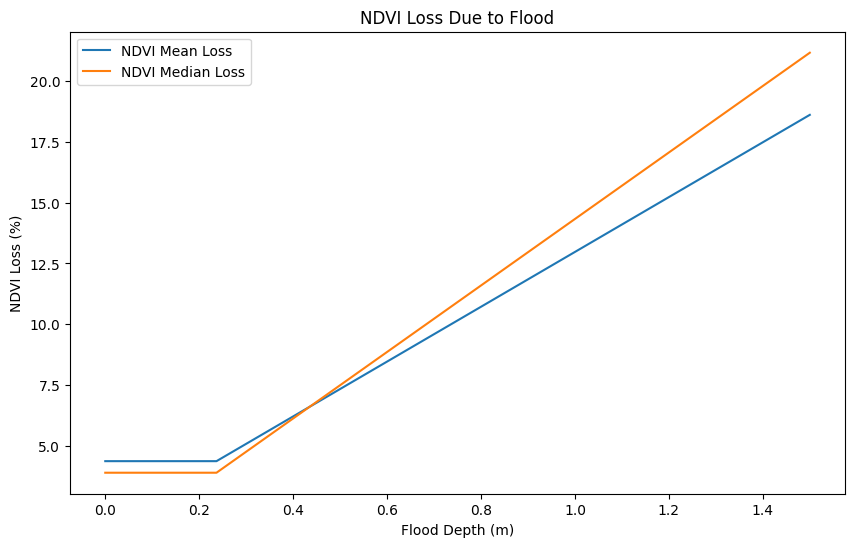

In [205]:
# Plot
fig, ax = plt.subplots(figsize=(10, 6))
flood_df.plot(x='flood_depth', y='NDVI_mean_loss', ax=ax, label='NDVI Mean Loss')
flood_df.plot(x='flood_depth', y='NDVI_median_loss', ax=ax, label='NDVI Median Loss')
ax.set_title('NDVI Loss Due to Flood')
ax.set_xlabel('Flood Depth (m)')
ax.set_ylabel('NDVI Loss (%)')
ax.legend()
plt.show()


In [206]:
# Calculate the probability of exceedance of NDVI loss given a flood depth
# Assuming a log-normal distribution for the NDVI loss

from scipy.stats import lognorm

# Fit a log-normal distribution to the NDVI loss data
params = lognorm.fit(flood_df['NDVI_mean_loss'])
print(f"Shape: {params[0]}, Location: {params[1]}, Scale: {params[2]}")

# Calculate the probability of exceedance for NDVI loss
flood_df['NDVI_loss_prob'] = lognorm.cdf(flood_df['NDVI_mean_loss'], params[0], loc=params[1], scale=params[2])

Shape: 14.59975053882781, Location: 4.359439016325578, Scale: 0.004128389930820375


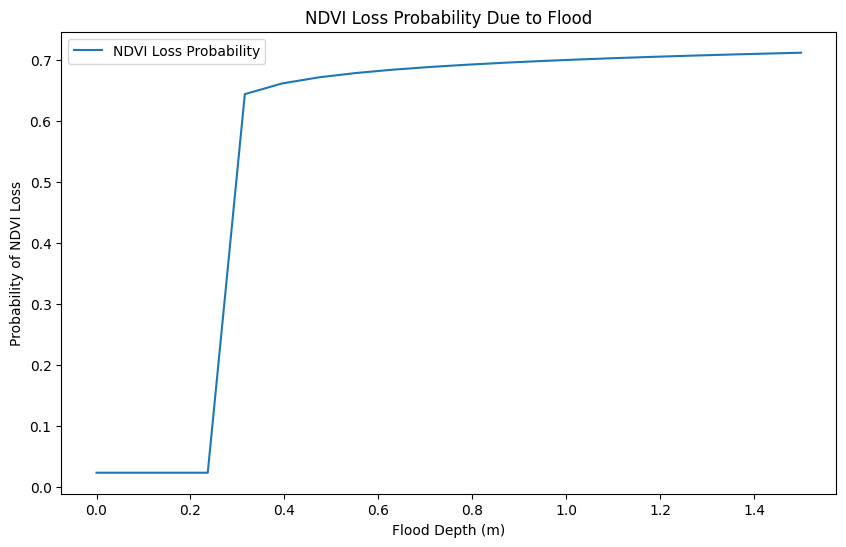

In [207]:
# Plot
fig, ax = plt.subplots(figsize=(10, 6))
flood_df.plot(x='flood_depth', y='NDVI_loss_prob', ax=ax, label='NDVI Loss Probability')
ax.set_title('NDVI Loss Probability Due to Flood')
ax.set_xlabel('Flood Depth (m)')
ax.set_ylabel('Probability of NDVI Loss')
plt.show()

In [144]:
# Export the probability of exceedance to a CSV file
flood_df.to_csv('../data/flood_ndvi_loss.csv', index=False)

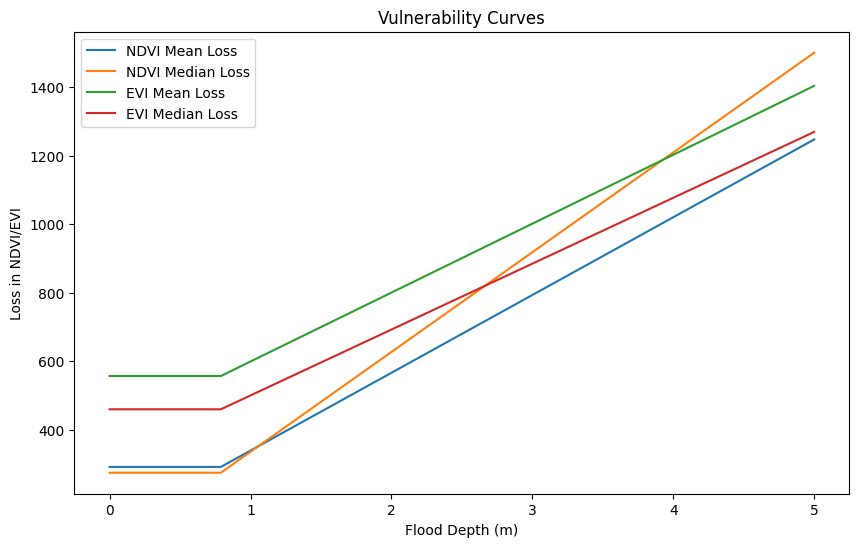

In [72]:
# Plot vulnerability curves

fig, ax = plt.subplots(figsize=(10, 6))
flood_df.plot(x='flood_depth', y='NDVI_mean_loss', ax=ax, label='NDVI Mean Loss')
flood_df.plot(x='flood_depth', y='NDVI_median_loss', ax=ax, label='NDVI Median Loss')
flood_df.plot(x='flood_depth', y='EVI_mean_loss', ax=ax, label='EVI Mean Loss')
flood_df.plot(x='flood_depth', y='EVI_median_loss', ax=ax, label='EVI Median Loss')
ax.set_title('Vulnerability Curves')
ax.set_xlabel('Flood Depth (m)')
ax.set_ylabel('Loss in NDVI/EVI')
ax.legend()

In [76]:
# Fit a lognormal distribution in each loss
from scipy.stats import lognorm

# Fit a lognormal distribution to the NDVI mean loss and save the parameters
params_ndvi_mean = lognorm.fit(flood_df['NDVI_mean_loss'])
params_ndvi_median = lognorm.fit(flood_df['NDVI_median_loss'])
params_evi_mean = lognorm.fit(flood_df['EVI_mean_loss'])
params_evi_median = lognorm.fit(flood_df['EVI_median_loss'])

